<h1 style="text-align: center;"><b>Object detection</b></h1>

##**1. Выбор фреймворка/библиотеки для использования детектора**


Буду использовать фреймворк torchvision.models.detection - модели для детектирования прямо из PyTorch.

##**2. Запуск детектора на случайных изображениях**

Для своих исследований буду использовать модель детектирования fasterrcnn_resnet50_fpn, её же здесь запущу на случайных изображениях.

In [1]:
import torch
from torchvision import transforms
from torchvision.models.detection import fasterrcnn_resnet50_fpn

import matplotlib.pyplot as plt
import matplotlib.patches as patches
%matplotlib inline

import numpy as np

from PIL import Image

In [2]:
test_model = fasterrcnn_resnet50_fpn(pretrained=True)

Downloading: "https://download.pytorch.org/models/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth" to /root/.cache/torch/hub/checkpoints/fasterrcnn_resnet50_fpn_coco-258fb6c6.pth


  0%|          | 0.00/160M [00:00<?, ?B/s]

Данная модель предобучалась на датасете COCO, со следующими категориями:

In [3]:
COCO_CATEGORIES = {
    0: '__background__', 1: 'person', 2: 'bicycle', 3: 'car', 4: 'motorcycle', 
    5: 'airplane', 6: 'bus', 7: 'train', 8: 'truck', 9: 'boat', 10: 'traffic light', 
    11: 'fire hydrant', 12: 'street sign', 13: 'stop sign', 14: 'parking meter', 15: 'bench',
    16: 'bird', 17: 'cat', 18: 'dog', 19: 'horse', 20: 'sheep', 21: 'cow', 22: 'elephant', 
    23: 'bear', 24: 'zebra', 25: 'giraffe', 26: 'hat', 27: 'backpack', 28: 'umbrella',
    29: 'shoe', 30: 'eye glasses', 31: 'handbag', 32: 'tie', 33: 'suitcase', 34: 'frisbee', 
    35: 'skis', 36: 'snowboard', 37: 'sports ball', 38: 'kite', 39: 'baseball bat', 
    40: 'baseball glove', 41: 'skateboard', 42: 'surfboard', 43: 'tennis racket', 44: 'bottle',
    45: 'plate', 46: 'wine glass', 47: 'cup', 48: 'fork', 49: 'knife', 50: 'spoon', 51: 'bowl', 
    52: 'banana', 53: 'apple', 54: 'sandwich', 55: 'orange', 56: 'broccoli', 57: 'carrot', 
    58: 'hot dog', 59: 'pizza', 60: 'donut', 61: 'cake', 62: 'chair', 63: 'couch', 64: 'potted plant',
    65: 'bed', 66: 'mirror', 67: 'dining table', 68: 'window', 69: 'desk', 70: 'toilet', 71: 'door', 
    72: 'tv', 73: 'laptop', 74: 'mouse', 75: 'remote', 76: 'keyboard', 77: 'cell phone', 78: 'microwave', 
    79: 'oven', 80: 'toaster', 81: 'sink', 82: 'refrigerator', 83: 'blender', 84: 'book', 85: 'clock', 
    86: 'vase', 87: 'scissors', 88: 'teddy bear', 89: 'hair drier', 90: 'toothbrush', 91: 'hair brush',
    }

COCO_linestyles = ['-', '--', '-.', ':'] * (92 // 4)

temp_colors = plt.cm.jet(np.linspace(0, 1, len(COCO_CATEGORIES)))
COCO_colors = {}
for i, c in enumerate(COCO_CATEGORIES):
    COCO_colors[COCO_CATEGORIES[c]] = temp_colors[i]

In [4]:
len(COCO_CATEGORIES), len(COCO_linestyles), len(COCO_colors)

(92, 92, 92)

Попробуем что-нибудь из списка подетектить.

In [5]:
CONF_THRESH = 0.9

In [6]:
def show_img(img, target, class_names, linestyles, classes_colors, fsize=(12,12)):

    boxes = target["boxes"][target['scores'] > CONF_THRESH]
    labels = target["labels"][target['scores'] > CONF_THRESH]

    fix, ax = plt.subplots(figsize=fsize)
    plt.axis('off')
    plt.imshow(img.permute(1,2,0))

    for i, box in enumerate(boxes):
        x1, y1, x2, y2  = box
        width, height = x2 - x1, y2 - y1
        name = class_names[int(labels[i])]

        rect = patches.Rectangle((x1, y1),
                                width, height,
                                linewidth = 3,
                                edgecolor = classes_colors[name],
                                facecolor = 'none',
                                label = name,
                                ls=linestyles[int(labels[i])],
                                )
        ax.add_patch(rect)
    
    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    plt.legend(by_label.values(), by_label.keys())

    plt.show()

Скачаем все тестовые картинки:

In [7]:
!wget https://catherineasquithgallery.com/uploads/posts/2021-02/1614515929_76-p-rost-na-belom-fone-93.jpg
!mv 1614515929_76-p-rost-na-belom-fone-93.jpg test1.jpg

!wget https://cs11.pikabu.ru/post_img/2018/06/16/10/og_og_152916491425410476.jpg
!mv og_og_152916491425410476.jpg test2.jpg

!wget https://regnum.ru/uploads/pictures/news/2019/07/03/regnum_picture_15621560252432402_normal.jpg
!mv regnum_picture_15621560252432402_normal.jpg test3.jpg

!wget https://avatars.mds.yandex.net/get-zen_doc/175411/pub_5c861c586508fd00b373ce0c_5c862ed859b73700b00c8f1a/scale_1200
!mv scale_1200 test4.jpg

!wget https://www.terroirist.com/wp-content/uploads/2021/02/pizzawine-1536x1152.jpg
!mv pizzawine-1536x1152.jpg test5.jpg

--2022-07-06 11:50:03--  https://catherineasquithgallery.com/uploads/posts/2021-02/1614515929_76-p-rost-na-belom-fone-93.jpg
Resolving catherineasquithgallery.com (catherineasquithgallery.com)... 46.4.96.188
Connecting to catherineasquithgallery.com (catherineasquithgallery.com)|46.4.96.188|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 219439 (214K) [image/jpeg]
Saving to: ‘1614515929_76-p-rost-na-belom-fone-93.jpg’

1614515929_76-p-ros 100%[===================>] 214.30K   568KB/s    in 0.4s    

2022-07-06 11:50:04 (568 KB/s) - ‘1614515929_76-p-rost-na-belom-fone-93.jpg’ saved [219439/219439]

--2022-07-06 11:50:05--  https://cs11.pikabu.ru/post_img/2018/06/16/10/og_og_152916491425410476.jpg
Resolving cs11.pikabu.ru (cs11.pikabu.ru)... 151.236.105.218
Connecting to cs11.pikabu.ru (cs11.pikabu.ru)|151.236.105.218|:443... connected.
HTTP request sent, awaiting response... 200 OK
Length: 421520 (412K) [image/jpeg]
Saving to: ‘og_og_152916491425410476.jpg’

og_

In [8]:
count = 5

imgs_tensor = []
for i in range(count):
    imgs_tensor.append(transforms.ToTensor()(Image.open(f'./test{i+1}.jpg')))

test_model.eval()
with torch.no_grad():
    pred = test_model(imgs_tensor)

In [9]:
for i in range(count):
    print(f"Picture {i+1}:")
    show_img(imgs_tensor[i], pred[i], COCO_CATEGORIES, COCO_linestyles, COCO_colors)

Output hidden; open in https://colab.research.google.com to view.

На представленных картинках видно, что модель отработала прекрасно на тестовых изображениях.

##**3. Выбор датасета**

Теперь начинается настоящая работа!  
Так как сейчас идёт турнир претендентов 2022 в Мадриде и я за ним слежу, то было решено, что буду дектировать шахматные фигуры на доске, и я стал искать датасет.  
Подходящий вариант я нашел на [roboflow](https://public.roboflow.com/object-detection/chess-full) - здесь же этот датасет был разбит на тренировочную, валидационную и тестовую выборки, но с соотношением первых двух выборок я не согласен, так как над ними я предпочитёл поэкспериментировать. Таким образом, я смешал тренировочную и валидационную выборки в одну тренировочную, тестовую же выборку я оставил нетронутой и получил следующую структуру:


- Chess Pieces  
    - train - 130 изображений и 130 их разметок в формате '.xml';
    - test - 29 изображений и 29 их разметок в формате '.xml'.

В этом пункте подгрузим все зависимости заново (чтобы можно было запускать всё последующее независимо от пунктов 1 и 2) и проделаем всю оставшуюся начальную рутину.

In [ ]:
import torch
import torch.nn as nn

from torch.utils.data import Dataset, DataLoader
from torch.utils.tensorboard import SummaryWriter
from sklearn.model_selection import train_test_split

from torchvision import transforms
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.models.detection.faster_rcnn import FastRCNNPredictor

import numpy as np
import pandas as pd
import os
import random
from PIL import Image

import matplotlib.pyplot as plt
import matplotlib.patches as patches
%matplotlib inline

import warnings
warnings.filterwarnings('ignore')

from tqdm.autonotebook import tqdm
from xml.etree import ElementTree as et

In [ ]:
SEED = 59
np.random.seed(SEED)
np.random.seed(SEED)
torch.manual_seed(SEED)
torch.cuda.manual_seed(SEED)

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
print(device)

cuda


Подключим диск, на котором лежит датасет - так удобнее для меня его хранить:

In [ ]:
from google.colab import drive

drive.mount("/content/gdrive/")

Mounted at /content/gdrive/


In [ ]:
PATH = '/content/gdrive/MyDrive/Colab Notebooks/DLS/Final Project/'
train_PATH = '/content/gdrive/MyDrive/Colab Notebooks/DLS/Final Project/Chess Pieces/train/'
test_PATH = '/content/gdrive/MyDrive/Colab Notebooks/DLS/Final Project/Chess Pieces/test/'

In [ ]:
CONF_THRESH = 0.9

Посмотрим на какое-нибудь изображение:

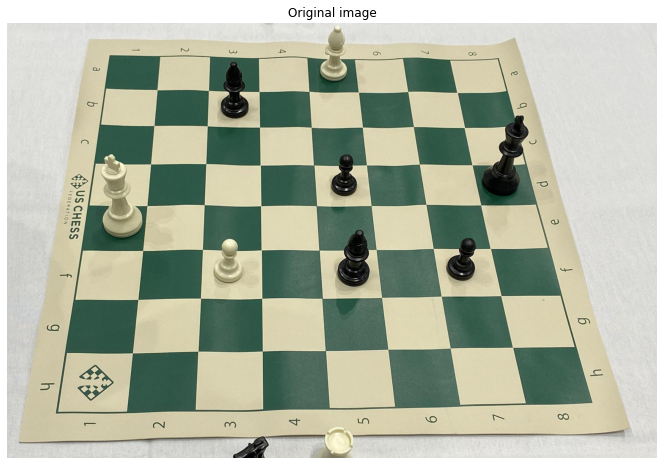

In [ ]:
with Image.open(train_PATH+"f1ea0167087976926d4fe0aa36b961ce_jpg.rf.245c4d4e37e289bbd69b90b60e6ee9bc.jpg") as image:
    plt.figure(figsize=(12,8))
    plt.axis('off')
    plt.title("Original image")
    plt.imshow(image)

##**4. Предобработка данных**

Напишем класс датасета для хранения изображений.

In [ ]:
class DetectionDataset(Dataset):
    def __init__(self, path, classes, transforms_img=None):
        super(DetectionDataset, self).__init__()

        self.transforms_img = transforms_img
        self.root_dir = path
        self.classes = classes

        self.filenames = []
        for root, dirs, files in os.walk(self.root_dir):
            for file in files:
                if file.endswith('.jpg'):
                    self.filenames.append(os.path.join(root, file))

    def __len__(self):
        return len(self.filenames)

    def init_target(self, xml_name, new_width, new_height):
        tree = et.parse(xml_name)
        boxes, labels = [], []

        sizes = tree.findall("size")[0]
        old_width = int(sizes.find("width").text)
        old_height = int(sizes.find("height").text)

        for element in tree.findall("object"):

            box = []

            xmin = int(element.find("bndbox/xmin").text)
            xmax = int(element.find("bndbox/xmax").text)
            ymin = int(element.find("bndbox/ymin").text)
            ymax = int(element.find("bndbox/ymax").text)

            # Скорректируем боксы по размеру картинки
            xmin = (xmin / old_width) * new_width
            xmax = (xmax / old_width) * new_width
            ymin = (ymin / old_height) * new_height
            ymax = (ymax / old_height) * new_height

            boxes.append([xmin, ymin, xmax, ymax])
            labels.append(self.classes.get(element.find("name").text, 0))
        
        return {'boxes': torch.Tensor(boxes), 'labels': torch.LongTensor(labels)}

    def __getitem__(self, idx):
        
        img_name = os.path.join(self.root_dir, self.filenames[idx])
        xml_name = img_name[:-3]+'xml'
        
        image = Image.open(img_name)

        if self.transforms_img:
            image = self.transforms_img(image)
            target = self.init_target(xml_name, image.shape[2], image.shape[1])
        else:
            target = self.init_target(xml_name, image.size[0], image.size[1])

        return image, target

Определим классы на изображениях и определим цвет и стиль линий для боксов каждого класса.

In [ ]:
classes = {
    'background': 0,
    'white-king': 1, 'white-queen': 2, 'white-bishop': 3, 'white-knight': 4, 'white-rook': 5, 'white-pawn': 6, 
    'black-king': 7, 'black-queen': 8, 'black-bishop': 9, 'black-knight': 10, 'black-rook': 11, 'black-pawn': 12,
    }

inverted_classes= {
    0: 'background',
    1: 'white-king', 2: 'white-queen', 3: 'white-bishop', 4: 'white-knight', 5: 'white-rook', 6: 'white-pawn', 
    7: 'black-king', 8: 'black-queen', 9: 'black-bishop', 10: 'black-knight', 11: 'black-rook', 12: 'black-pawn',
    }

linestyles = [None] + ['-', '--', '-.', ':']*3

colors = plt.cm.jet(np.linspace(0, 1, len(classes)))
classes_colors = {}
for i, c in enumerate(classes):
    classes_colors[c] = colors[i]

Теперь обсудим аугументацию данных.

In [ ]:
img_width = 512
img_height = 343

transforms_img = {
    'train': transforms.Compose([
                                 transforms.Resize((img_height, img_width)),
                                 transforms.ColorJitter(brightness=0.4, contrast=0.3, saturation=0.3, hue=0.2),
                                 transforms.GaussianBlur(kernel_size=3, sigma=(0.05, 0.7)),
                                 transforms.ToTensor(),
                                 ]),
    'test': transforms.Compose([
                                transforms.ToTensor(),
                                ]),
    }

Каждая используемая аугументация подразумевает неточность картинки в камере, которая снимает доску с фигурами (при том случаная обрезка изображения не используется, так как из-за этого страдают боксы). Давайте посмотрим на каждую аугументацию по отдельности.

In [ ]:
def print_with_transformation(img, transform_img, count=3):
    plt.figure(figsize=(18,12))

    for i in range(count):
        plt.subplot(2, count, i+1)
        plt.axis('off')
        plt.title("Original image")
        plt.imshow(img)

        plt.subplot(2, count, i+count+1)
        plt.axis('off')
        plt.title("Transformed image")
        plt.imshow(transform_img(img))

In [ ]:
temp_img = Image.open(train_PATH+"f1ea0167087976926d4fe0aa36b961ce_jpg.rf.245c4d4e37e289bbd69b90b60e6ee9bc.jpg")

1. transforms.Resize((img_height, img_width)) - уменьшим размерность изображения, чтобы поместить большее их количество в один батч, при этом соханяя примерно начальное соотношение между длинной и шириной картинки (изначально размер всех картинок 2048 на 1371, мы же сделаем 512 на 343).

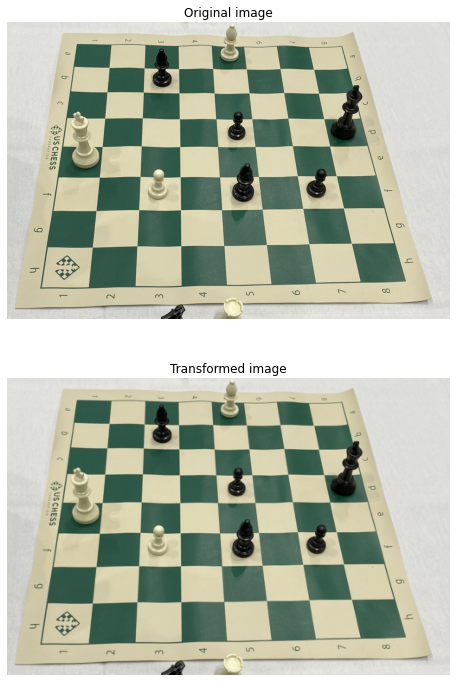

In [ ]:
print_with_transformation(temp_img, transforms.Resize((img_height, img_width)), count=1)

2. transforms.ColorJitter(brightness=0.4, contrast=0.3, saturation=0.3, hue=0.2) - данная трансформация имитирует искажённость картинки, которую может передавать камера (например, плохое освещение). Все числовые параметры трансформации подобраны экспериментально.

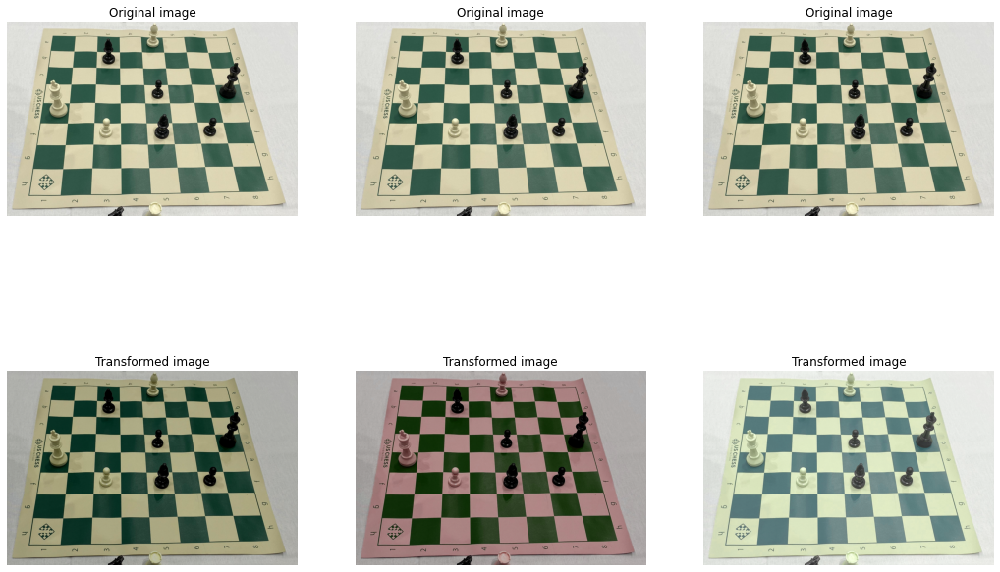

In [ ]:
print_with_transformation(temp_img, transforms.ColorJitter(brightness=0.4, contrast=0.3, saturation=0.3, hue=0.2), count=3)

3. transforms.GaussianBlur(kernel_size=3, sigma=(0.01, 0.7)) - здесь просто чуть уменьшаем детализацию изображения, что может имитировать нелучшую снимающую доску камеру. 

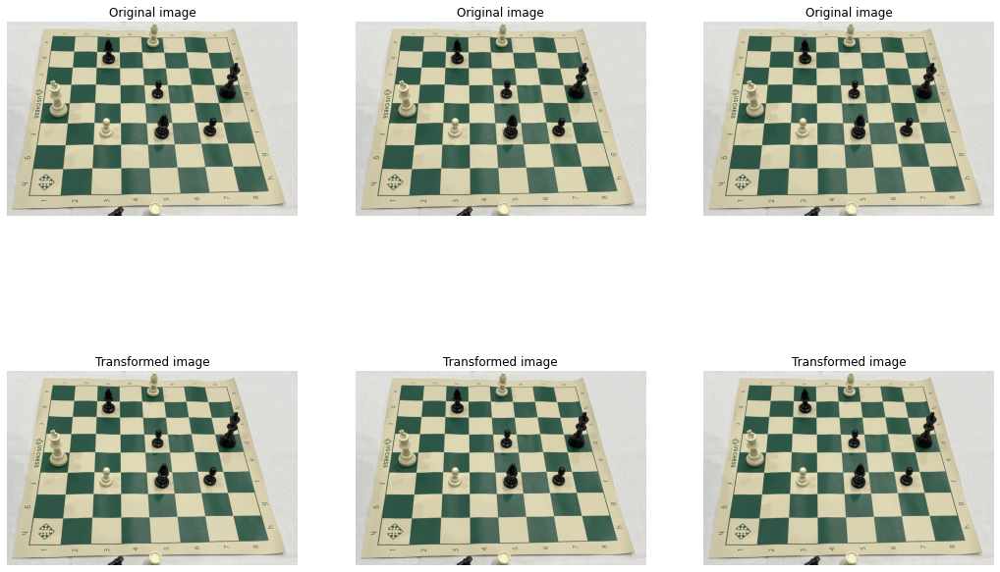

In [ ]:
print_with_transformation(temp_img, transforms.GaussianBlur(kernel_size=3, sigma=(0.05, 0.7)), count=3)

Может возникнуть вопрос, почему не используется нормализация изображения transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]). Ответ следующий: из-за неё черные фигуры сливаются с доской, что и продемонстрировано ниже и модель плохо на этих данных обучается (проверено экспериментально).

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


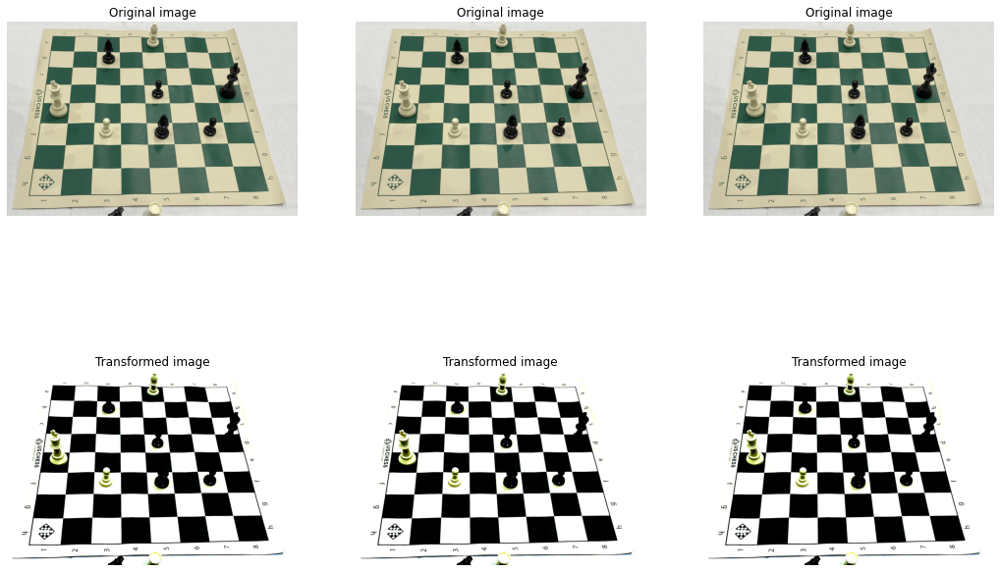

In [ ]:
class Permute120(object):
    def __call__(self, img_tensor):
        return img_tensor.permute(1,2,0)

    def __repr__(self):
        return self.__class__.__name__+'()'

temp_transforms_img = transforms.Compose([
                                 transforms.ToTensor(),
                                 transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
                                 Permute120(),
                                 ])

print_with_transformation(temp_img, temp_transforms_img, count=3)

Создадим датасет.

In [ ]:
dataset = DetectionDataset(train_PATH, classes, transforms_img['train'])
test_dataset = DetectionDataset(test_PATH, classes, transforms_img['test'])

Разобьём обучающую выборку на тренировочную и валидационную.

In [ ]:
train_dataset, val_dataset = train_test_split(dataset, train_size=0.8, random_state=59)

In [ ]:
len(dataset), len(train_dataset), len(val_dataset)

(260, 208, 52)

И получим даталоадер.

In [ ]:
def collate_fn(batch):
    return tuple(zip(*batch))

train_loader = torch.utils.data.DataLoader(train_dataset, batch_size=4, shuffle=True, collate_fn=collate_fn)
val_loader = torch.utils.data.DataLoader(val_dataset, batch_size=4, shuffle=False, collate_fn=collate_fn)
test_loader = torch.utils.data.DataLoader(test_dataset, batch_size=1, shuffle=False, collate_fn=collate_fn)

Посомотрим на случайное изображение из треноровочной выборки и на его боксы.

In [ ]:
def show_img(img, target, class_names, linestyles, classes_colors, fsize=(12,12)):

    if 'scores' in target.keys():
        boxes = target["boxes"][target['scores'] > CONF_THRESH]
        labels = target["labels"][target['scores'] > CONF_THRESH]
    else:
        boxes = target["boxes"]
        labels = target["labels"]

    fix, ax = plt.subplots(figsize=fsize)
    plt.axis('off')
    plt.imshow(img.permute(1,2,0))

    for i, box in enumerate(boxes):
        x1, y1, x2, y2  = box
        width, height = x2 - x1, y2 - y1
        name = class_names[int(labels[i])]

        rect = patches.Rectangle((x1, y1),
                                width, height,
                                linewidth = 3,
                                edgecolor = classes_colors[name],
                                facecolor = 'none',
                                label = name,
                                ls=linestyles[int(labels[i])],
                                )
        ax.add_patch(rect)
    
    handles, labels = plt.gca().get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    plt.legend(by_label.values(), by_label.keys())

    plt.show()

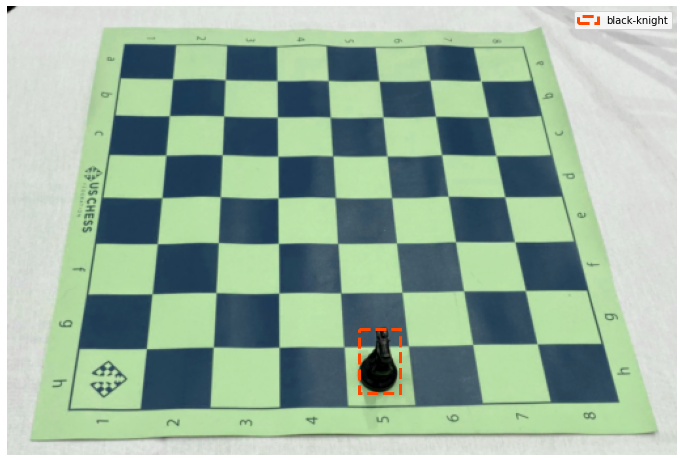

In [ ]:
inputs, targets = next(iter(train_loader))
show_img(inputs[0], targets[0], inverted_classes, linestyles, classes_colors)

Теперь можем приступать к обучению!

##**5. Обучение модели-детектора** 


In [ ]:
def get_model(num_classes):
    model = fasterrcnn_resnet50_fpn(pretrained=True)
    in_features = model.roi_heads.box_predictor.cls_score.in_features
    model.roi_heads.box_predictor = FastRCNNPredictor(in_features, num_classes) 
    return model

In [ ]:
def show_results(train_losses, val_losses, epoch, fsize=(12, 6)):
    plt.figure(figsize=fsize)
    plt.plot(train_losses, label="train_loss")
    plt.plot(val_losses, label="val_loss")
    plt.legend()
    plt.xlabel("epochs")
    plt.ylabel("loss")
    plt.title(f'Epoch {epoch} results')
    plt.show()

def save_nn(model, optimizer, lr_scheduler, epochs, epoch, train_history, val_history, path):
    torch.save({
        'epochs': epochs,
        'last_epoch': epoch, 
        'model_state_dict': model.state_dict(),
        'optimizer_state_dict': optimizer.state_dict(),
        'lr_scheduler_state_dict': lr_scheduler.state_dict(),
        'train_history': train_history,
        'val_history': val_history,
    }, path)

def load_nn(model, optimizer, lr_scheduler, path):
    checkpoint = torch.load(path, map_location=torch.device(device)) if os.path.exists(path) else 0
    history = []
    if checkpoint:
        epochs = checkpoint['epochs']
        start_epoch = checkpoint['last_epoch'] + 1
        model.load_state_dict(checkpoint['model_state_dict'])
        optimizer.load_state_dict(checkpoint['optimizer_state_dict'])
        lr_scheduler.load_state_dict(checkpoint['lr_scheduler_state_dict'])
        train_history = checkpoint['train_history']
        val_history = checkpoint['val_history']
        show_results(train_history, val_history, start_epoch-1)
    else:
        start_epoch = 0
        train_history = []
        val_history = []

    return model, optimizer, lr_scheduler, start_epoch, train_history, val_history

In [ ]:
def train(model, optimizer, lr_scheduler, train_loader, val_loader, epochs=20, name='checkpoint.pt'):
    
    writer = SummaryWriter()
    train_losses, val_losses = [], []
    start_epoch = 0

    model, optimizer, lr_scheduler, start_epoch, train_losses, val_losses = load_nn(model, optimizer, lr_scheduler, PATH+name)

    for epoch in tqdm(range(start_epoch, epochs), desc='Epochs'):

        model.train()
        
        train_running_loss, val_running_loss = 0, 0
        train_epoch_loss, val_epoch_loss = 0, 0
        
        for inputs, targets in tqdm(train_loader, desc=f'Training epoch {epoch}', leave=False):

            inputs = [img.to(device) for img in inputs]
            targets = [{k: v.to(device) for k, v in t.items()} for t in targets]
            
            optimizer.zero_grad()

            loss_dict = model(inputs, targets)
            losses = np.sum(loss for loss in loss_dict.values())
            losses.backward()
            optimizer.step()

            train_running_loss += losses.item()
            
            del inputs, targets
            torch.cuda.empty_cache()

        with torch.no_grad():
            for inputs, targets in tqdm(val_loader, desc=f'Validating epoch {epoch}', leave=False):
                inputs = [img.to(device) for img in inputs]
                targets = [{k: v.to(device) for k, v in t.items()} for t in targets]

                loss_dict = model(inputs, targets)

                losses = np.sum(loss for loss in loss_dict.values())
                val_running_loss += losses.item()

                del inputs, targets
                torch.cuda.empty_cache()
        
        train_epoch_loss = train_running_loss / len(train_loader)
        val_epoch_loss = val_running_loss / len(val_loader)
        train_losses.append(train_epoch_loss)
        val_losses.append(val_epoch_loss)

        print(f'Epoch {epoch} | Train Loss: {train_epoch_loss:.4f} | Val Loss: {val_epoch_loss:.4f}')

        if epoch % 10 == 0 and epoch:
            save_nn(model, optimizer, lr_scheduler, epochs, epoch, train_losses, val_losses, PATH+name)
            show_results(train_losses, val_losses, epoch)
        
        lr_scheduler.step()

        writer.add_scalar('Loss/train', train_epoch_loss, epoch)
        writer.add_scalar('Loss/valid', val_epoch_loss, epoch)

    save_nn(model, optimizer, lr_scheduler, epochs, epoch, train_losses, val_losses, PATH+name)
    
    show_results(train_losses, val_losses, epochs)
    writer.flush()
    return model, train_losses, val_losses

In [ ]:
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')

num_classes = len(classes)

detection_model = get_model(num_classes)
detection_model = detection_model.to(device)

optimizer = torch.optim.Adam(detection_model.parameters(), lr=1e-3)

lr_scheduler = torch.optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.5)

Хотя данных и не так много, будем обучать 30 эпох


Epochs:   0%|          | 0/30 [00:00<?, ?it/s]

Training epoch 0:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 0:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 0 | Train Loss: 4.2608 | Val Loss: 1.2297


Training epoch 1:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 1:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 1 | Train Loss: 0.8999 | Val Loss: 1.0397


Training epoch 2:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 2:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 2 | Train Loss: 0.8463 | Val Loss: 1.0654


Training epoch 3:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 3:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 3 | Train Loss: 0.8603 | Val Loss: 1.0284


Training epoch 4:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 4:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 4 | Train Loss: 0.8197 | Val Loss: 0.9718


Training epoch 5:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 5:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 5 | Train Loss: 0.6988 | Val Loss: 0.8087


Training epoch 6:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 6:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 6 | Train Loss: 0.6245 | Val Loss: 0.8314


Training epoch 7:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 7:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 7 | Train Loss: 0.5843 | Val Loss: 0.6900


Training epoch 8:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 8:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 8 | Train Loss: 0.5050 | Val Loss: 0.6282


Training epoch 9:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 9:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 9 | Train Loss: 0.5142 | Val Loss: 0.6272


Training epoch 10:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 10:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 10 | Train Loss: 0.4363 | Val Loss: 0.5606


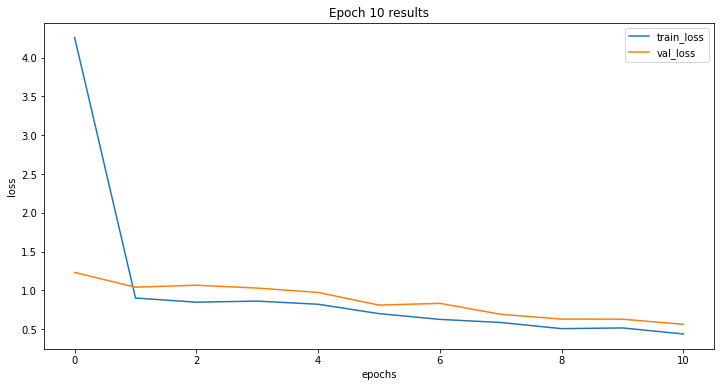

Training epoch 11:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 11:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 11 | Train Loss: 0.3974 | Val Loss: 0.4810


Training epoch 12:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 12:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 12 | Train Loss: 0.3960 | Val Loss: 0.5135


Training epoch 13:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 13:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 13 | Train Loss: 0.3623 | Val Loss: 0.4476


Training epoch 14:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 14:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 14 | Train Loss: 0.3233 | Val Loss: 0.4203


Training epoch 15:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 15:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 15 | Train Loss: 0.3207 | Val Loss: 0.3890


Training epoch 16:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 16:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 16 | Train Loss: 0.3079 | Val Loss: 0.4202


Training epoch 17:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 17:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 17 | Train Loss: 0.2977 | Val Loss: 0.4077


Training epoch 18:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 18:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 18 | Train Loss: 0.3055 | Val Loss: 0.4083


Training epoch 19:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 19:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 19 | Train Loss: 0.2662 | Val Loss: 0.3604


Training epoch 20:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 20:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 20 | Train Loss: 0.2350 | Val Loss: 0.3377


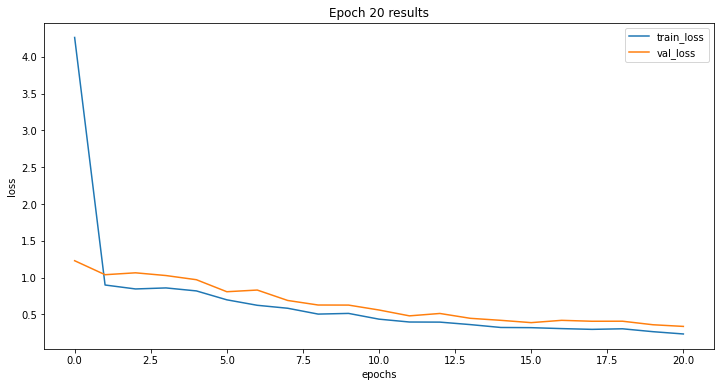

Training epoch 21:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 21:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 21 | Train Loss: 0.2174 | Val Loss: 0.3376


Training epoch 22:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 22:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 22 | Train Loss: 0.2164 | Val Loss: 0.3112


Training epoch 23:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 23:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 23 | Train Loss: 0.2072 | Val Loss: 0.3118


Training epoch 24:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 24:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 24 | Train Loss: 0.1937 | Val Loss: 0.2773


Training epoch 25:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 25:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 25 | Train Loss: 0.1924 | Val Loss: 0.2979


Training epoch 26:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 26:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 26 | Train Loss: 0.1799 | Val Loss: 0.2785


Training epoch 27:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 27:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 27 | Train Loss: 0.1728 | Val Loss: 0.2762


Training epoch 28:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 28:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 28 | Train Loss: 0.1732 | Val Loss: 0.2758


Training epoch 29:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 29:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 29 | Train Loss: 0.1670 | Val Loss: 0.2816


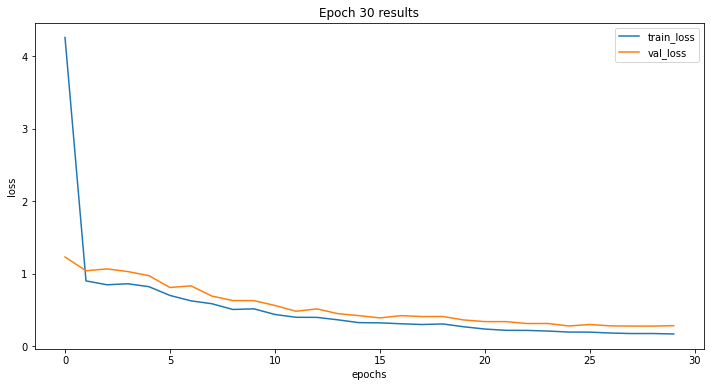

In [ ]:
detection_model, train_losses, val_losses = train(detection_model, optimizer, lr_scheduler, train_loader, val_loader, 30, 'checkpoint.pt')

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir=/content/runs

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
detection_model.eval()
preds = []
with torch.no_grad():
    for imgs, targets in test_loader:
        batch_images = [img.to(device) for img in imgs]
        preds += detection_model(batch_images)

In [ ]:
def print_img(ax, img, boxes, labels, class_names, linestyles, classes_colors, plt_name):
    
    ax.axis('off')
    ax.set_title(plt_name, fontsize=24)
    ax.imshow(img.permute(1,2,0))

    for i, box in enumerate(boxes):
        x1, y1, x2, y2  = box
        width, height = x2 - x1, y2 - y1

        name = class_names[int(labels[i])]

        rect = patches.Rectangle((x1, y1),
                                width, height,
                                linewidth = 3,
                                edgecolor = classes_colors[name],
                                facecolor = 'none',
                                label = name,
                                ls=linestyles[int(labels[i])],
                                )
        ax.add_patch(rect)
    
    handles, labels = ax.get_legend_handles_labels()
    by_label = dict(zip(labels, handles))
    ax.legend(by_label.values(), by_label.keys(), fontsize=14)


def print_results(img, target, pred, class_names, linestyles, classes_colors, fsize=(10,10)):

    boxes_target= target["boxes"]
    labels_target = target["labels"]

    boxes_pred = pred["boxes"][pred['scores'] > CONF_THRESH]
    labels_pred = pred["labels"][pred['scores'] > CONF_THRESH]

    fig, ax = plt.subplots(1, 2, figsize=fsize)
    print_img(ax[0], img.cpu(), boxes_target.cpu(), labels_target.cpu(), inverted_classes, linestyles, classes_colors, "Real")
    print_img(ax[1], img.cpu(), boxes_pred.cpu(), labels_pred.cpu(), inverted_classes, linestyles, classes_colors, "Predicted")


def model_results(dataset, pred, idx=None, count=5):
    if not idx:
        idx = random.sample(range(len(dataset)), count)

    for j, i in enumerate(idx):
        temp_photo, temp_target = dataset[i]
        temp_pred = pred[i]
        print_results(temp_photo, temp_target, temp_pred, inverted_classes, linestyles, classes_colors, (40, 40))
    
    return idx

Пострим на резульататы. Отмечу, что бралась вероятность больше 90 процентов.

In [ ]:
idx = model_results(test_loader.dataset, preds, None, 5)

Output hidden; open in https://colab.research.google.com to view.

Видно, что моделька по большей части справляется, но иногда пропускает фигуры. Попробуем дообучить её ещё на 10 эпохах.

In [ ]:
detection_model2 = get_model(num_classes)
detection_model2 = detection_model2.to(device)

optimizer2 = torch.optim.Adam(detection_model2.parameters(), lr=1e-3)

lr_scheduler2 = torch.optim.lr_scheduler.StepLR(optimizer2, step_size=10, gamma=0.5)

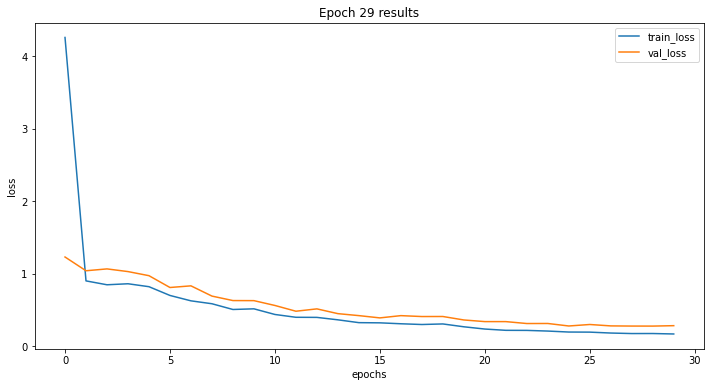

Epochs:   0%|          | 0/10 [00:00<?, ?it/s]

Training epoch 30:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 30:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 30 | Train Loss: 0.1472 | Val Loss: 0.2534


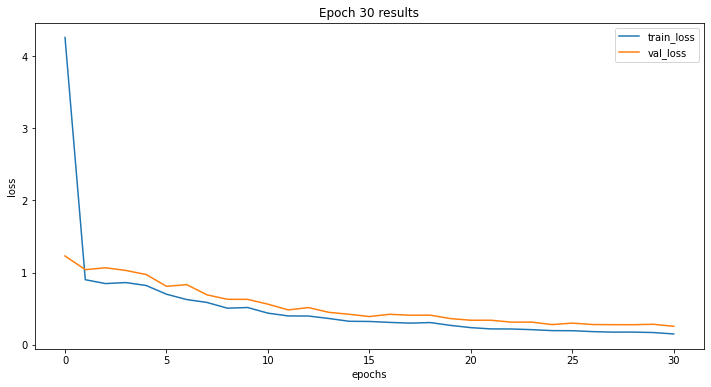

Training epoch 31:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 31:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 31 | Train Loss: 0.1382 | Val Loss: 0.2543


Training epoch 32:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 32:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 32 | Train Loss: 0.1365 | Val Loss: 0.2685


Training epoch 33:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 33:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 33 | Train Loss: 0.1326 | Val Loss: 0.2541


Training epoch 34:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 34:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 34 | Train Loss: 0.1291 | Val Loss: 0.2544


Training epoch 35:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 35:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 35 | Train Loss: 0.1270 | Val Loss: 0.2513


Training epoch 36:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 36:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 36 | Train Loss: 0.1203 | Val Loss: 0.2479


Training epoch 37:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 37:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 37 | Train Loss: 0.1227 | Val Loss: 0.2466


Training epoch 38:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 38:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 38 | Train Loss: 0.1201 | Val Loss: 0.2458


Training epoch 39:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 39:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 39 | Train Loss: 0.1201 | Val Loss: 0.2444


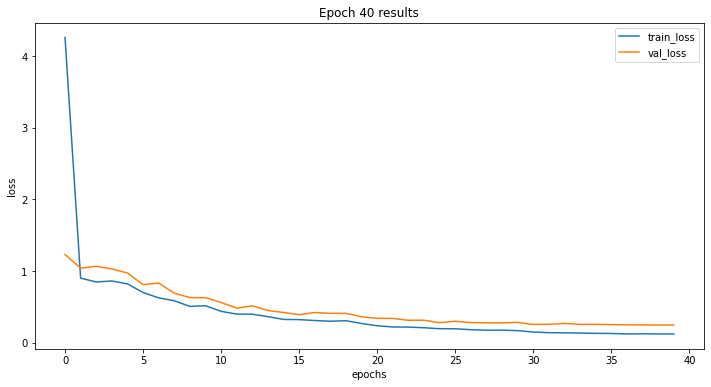

In [ ]:
detection_model2, train_losses2, val_losses2 = train(detection_model2, optimizer2, lr_scheduler2, train_loader, val_loader, 40, 'checkpoint.pt')

Видим, что Val loss убывает медленнее, чем Train Loss.

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir=/content/runs

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
detection_model2.eval()
preds2 = []
with torch.no_grad():
    for imgs, targets in test_loader:
        batch_images = [img.to(device) for img in imgs]
        preds2 += detection_model2(batch_images)

In [ ]:
model_results(test_loader.dataset, preds2, idx)

Output hidden; open in https://colab.research.google.com to view.

Результат улучшился:
1. На первой картинке доопределился конь на g2;
2. На второй картинке задектировалась фигура, но неверно (но уже она замечена!);
3. На 3 картинке верно доопределилась королева на d6;
4. На 4 картинке была замечена ладья на a8 и конь на g6, но перестала определяться королева на e5 (на 30 эпохах она детектировалась как король).

Видим, что дообучение работает, поэтому грех дальше его не продолжать. На этот раз дообучим ещё на 20 эпох.

In [ ]:
detection_model3 = get_model(num_classes)
detection_model3 = detection_model3.to(device)

optimizer3 = torch.optim.Adam(detection_model3.parameters(), lr=1e-3)

lr_scheduler3 = torch.optim.lr_scheduler.StepLR(optimizer3, step_size=10, gamma=0.5)

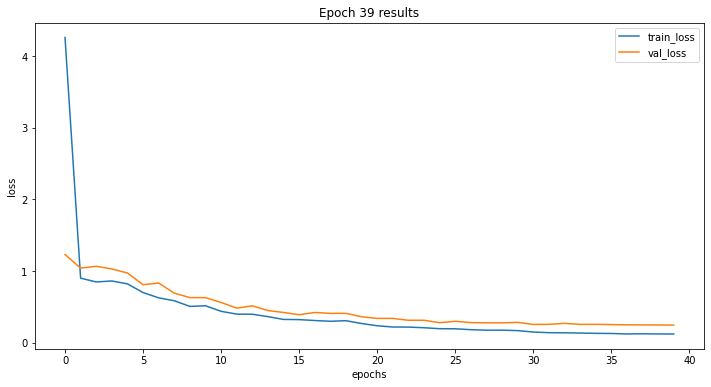

Epochs:   0%|          | 0/20 [00:00<?, ?it/s]

Training epoch 40:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 40:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 40 | Train Loss: 0.1115 | Val Loss: 0.2472


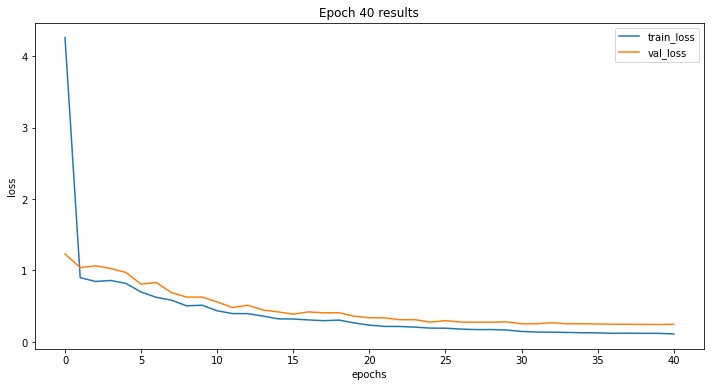

Training epoch 41:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 41:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 41 | Train Loss: 0.1055 | Val Loss: 0.2425


Training epoch 42:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 42:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 42 | Train Loss: 0.1035 | Val Loss: 0.2436


Training epoch 43:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 43:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 43 | Train Loss: 0.1019 | Val Loss: 0.2410


Training epoch 44:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 44:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 44 | Train Loss: 0.1009 | Val Loss: 0.2455


Training epoch 45:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 45:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 45 | Train Loss: 0.0977 | Val Loss: 0.2469


Training epoch 46:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 46:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 46 | Train Loss: 0.1005 | Val Loss: 0.2385


Training epoch 47:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 47:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 47 | Train Loss: 0.0966 | Val Loss: 0.2446


Training epoch 48:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 48:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 48 | Train Loss: 0.0987 | Val Loss: 0.2409


Training epoch 49:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 49:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 49 | Train Loss: 0.0975 | Val Loss: 0.2433


Training epoch 50:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 50:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 50 | Train Loss: 0.0900 | Val Loss: 0.2392


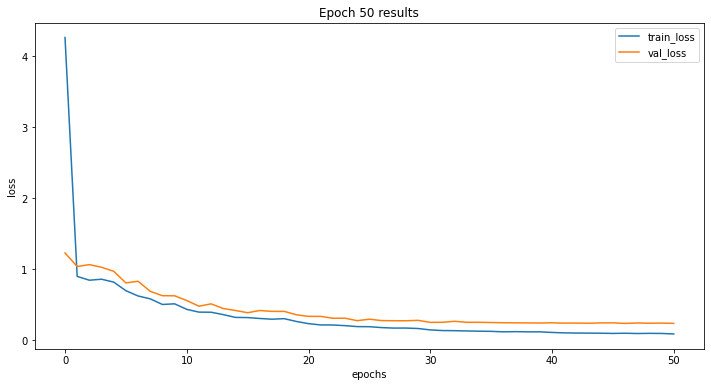

Training epoch 51:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 51:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 51 | Train Loss: 0.0886 | Val Loss: 0.2387


Training epoch 52:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 52:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 52 | Train Loss: 0.0861 | Val Loss: 0.2407


Training epoch 53:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 53:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 53 | Train Loss: 0.0860 | Val Loss: 0.2422


Training epoch 54:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 54:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 54 | Train Loss: 0.0854 | Val Loss: 0.2447


Training epoch 55:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 55:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 55 | Train Loss: 0.0839 | Val Loss: 0.2365


Training epoch 56:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 56:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 56 | Train Loss: 0.0850 | Val Loss: 0.2430


Training epoch 57:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 57:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 57 | Train Loss: 0.0840 | Val Loss: 0.2442


Training epoch 58:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 58:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 58 | Train Loss: 0.0824 | Val Loss: 0.2378


Training epoch 59:   0%|          | 0/52 [00:00<?, ?it/s]

Validating epoch 59:   0%|          | 0/13 [00:00<?, ?it/s]

Epoch 59 | Train Loss: 0.0822 | Val Loss: 0.2355


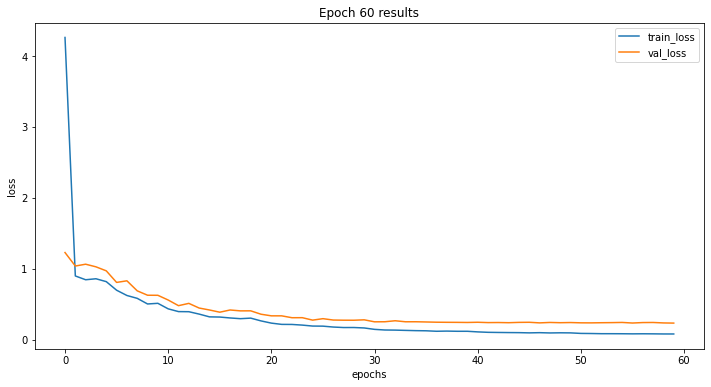

In [ ]:
detection_model3, train_losses3, val_losses3 = train(detection_model3, optimizer3, lr_scheduler3, train_loader, val_loader, 60, 'checkpoint.pt')

Всё, Train Loss продолжает падать, а Val Loss вышел на плато. Дальше модель, скорее всего, будет переобучаться.

In [ ]:
%reload_ext tensorboard
%tensorboard --logdir=/content/runs

Output hidden; open in https://colab.research.google.com to view.

In [ ]:
detection_model3.eval()
preds3 = []
with torch.no_grad():
    for imgs, targets in test_loader:
        batch_images = [img.to(device) for img in imgs]
        preds3 += detection_model3(batch_images)

In [ ]:
model_results(test_loader.dataset, preds3, idx)

Output hidden; open in https://colab.research.google.com to view.

Результаты на рассматриваемых картинках не изменились. Дальше обучать не имеет смысла, что также видно по лоссам.  
Как мне кажется, увеличив датасет, можно добиться лучшего результата.

##**7. Поиск путей применения этой модели в бизнесе и реальных задачах**

В голову приходят два сценария:
1. **Использование усовершенствованной модели в шахматных школах и турнирах.**  
Под усовершенствованием я понимаю добавление функции, определяющей клетку, на которой находится фигура, тогда можно будет обычной камерой заменить электронные доски; добавление возможности детектирования в прямом эфире; обучение на фигурах из разных шахматных наборах (то есть увеличение датасета).  
Электронная доска - доска, которая подключается к компьютеру и определяет расположение фигур во время партии. Стоимость одной такой доски от 40 тысяч рублей,  но таких досок нужно несколько, что многие школы и организаторы локальных офлайн турниров позволить себе не могут. Теперь же её можно будет заменить любым смартфоном или камерой, которые смогут транслировать видео.  
Добавление возможности детектирования в прямом эфире поможет записывать партию сразу в базу и ее можно будет проссматривать оналайн, не находясь физически в месте проведения игры.  
Обучение на разных шахматных наборах позволит сделать детектирующую возможность модели просто шире.
2. **Восстановление старых партий по плохому видео.**  
Не все партии на старых турнирах записывались и вносились в базу шахматных игр, но их видео вполне могло сохранится в плохом качестве. Данную модель можно применить в попытке восстановить партию, записанную в плохом качетсве на видео с помощью детектирования фигур и восстановлением логики игры.